In [1]:
import barnaba as bb
import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster, leaves_list
from scipy.spatial.distance import squareform
from scipy.stats import pearsonr, spearmanr
import matplotlib.pyplot as plt
import seaborn as sns
import os
from MDAnalysis import Universe
from MDAnalysis.coordinates.PDB import PDBWriter
from collections import defaultdict
import json
import glob

/Users/massimodellepiane/Developer/MD_analysis/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def load_ermsd_matrix(load_path):
    # Load the matrix from the specified path
    return np.loadtxt(load_path, delimiter=',') 

In [3]:
def visualize_ermsd_matrix(ermsd_matrix, labels=None):
    """
    Visualizes the eRMSD matrix as a color-coded heatmap.
    
    Parameters:
    ermsd_matrix (np.array): A 2D NumPy array containing the eRMSD values.
    labels (list): Optional; a list of labels for the PDB files.
    """
    # Set the context and style of the plot for better readability
    #sns.set(context='notebook', style='white')

    # Determine the color scale limits
    vmin = np.min(ermsd_matrix)
    vmax = np.max(ermsd_matrix)

    # Create the heatmap using Seaborn
    plt.figure(figsize=(12, 8), dpi=300, facecolor='w')
    ax = sns.heatmap(ermsd_matrix, annot=False, fmt=".2f", cmap='viridis', 
                     linewidths=0, square=True, cbar_kws={"shrink": .5}, vmin=vmin, vmax=vmax)

    # Label the axes if labels are provided
    if labels:
        ax.set_xticklabels(labels, rotation=45, ha='right')
        ax.set_yticklabels(labels, rotation=0)
    
    # Set axis labels
    ax.set_xlabel('Structure')
    ax.set_ylabel('Structure')
    
    # Title of the heatmap
    ax.set_title('eRMSD Heatmap')

    # Show the plot
    plt.show()

In [4]:
def visualize_clustered_ermsd_matrix(nrmsd_matrix, Z, max_d):
    """
    Visualizes the eRMSD matrix as a color-coded heatmap, rearranged according to hierarchical clustering,
    with a dendrogram representing the clustering plotted alongside the heatmap without axis labels.

    Parameters:
    ermsd_matrix (np.array): A 2D NumPy array containing the eRMSD values.
    Z (np.array): Linkage matrix from hierarchical clustering.
    max_d (float): Threshold distance to define clusters.
    """

    # Determine the number of observations
    n = nrmsd_matrix.shape[0]

    # Create a figure to contain both the dendrogram and the heatmap
    fig = plt.figure(figsize=(12, 8), dpi=300, facecolor='w')

    # Create dendrogram axes
    ax_dendro = fig.add_axes([0.05, 0.1, 0.225, 0.6], frame_on=False)  # Adjusted width
    dendrogram_result = dendrogram(Z, orientation='left', color_threshold=max_d, above_threshold_color='k', no_labels=True, ax=ax_dendro)
    ax_dendro.set_xticks([])
    ax_dendro.set_yticks([])

    # Turn off the axis
    ax_dendro.axis('off')

    # Identify the order of the rows according to the dendrogram and reverse it
    Z_idx = dendrogram_result['leaves'][::-1]

    # Reorder the NRMSD matrix according to the clustering
    nrmsd_matrix_ordered = nrmsd_matrix[Z_idx, :][:, Z_idx]

    # Create heatmap axes
    ax_heatmap = fig.add_axes([0.2, 0.1, 0.6, 0.6])  # Adjusted position
    sns.heatmap(nrmsd_matrix_ordered, annot=False, cmap='viridis', linewidths=0, square=True, cbar_kws={"shrink": .5}, ax=ax_heatmap)

    # Turn off the axis labels
    ax_heatmap.set_xticks([])
    ax_heatmap.set_yticks([])

    # Set title
    plt.title('Clustered eRMSD Heatmap', loc='center')

    # Show the plot
    plt.show()

In [5]:
def get_pdb_files_by_cluster(clusters, all_pdb_files):
    cluster_files = {i: [] for i in set(clusters)}

    for file, cluster in zip(all_pdb_files, clusters):
        cluster_files[cluster].append(file)

    return cluster_files

In [6]:
def save_cluster_trajectories(pdb_files_by_cluster, output_folder):
    """
    Saves PDB trajectory files for each cluster based on the provided dictionary.
    
    Parameters:
    pdb_files_by_cluster (dict): Dictionary where keys are cluster IDs and values are lists of PDB file paths.
    output_folder (str): Path to the folder where the cluster trajectory files will be saved.
    """
    # Ensure the output folder exists
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    for cluster_id, pdb_files in pdb_files_by_cluster.items():
        # Initialize the PDBWriter for the current cluster
        cluster_file_path = os.path.join(output_folder, f"cluster_{cluster_id}.pdb")
        with PDBWriter(cluster_file_path, multiframe=True) as pdb_writer:
            for pdb_file in pdb_files:
                # Load the PDB file using MDAnalysis
                u = Universe(pdb_file)
                
                # Write the PDB structure as a new frame in the cluster trajectory file
                pdb_writer.write(u.atoms)
    
    print("Cluster trajectory files have been saved.")

In [7]:
def parse_cd_file(file_path):
    """
    Parses a .cd file to extract wavelength and intensity data.
    
    Parameters:
    file_path (str): Path to the .cd file.
    
    Returns:
    tuple: Two numpy arrays containing the wavelength and intensity data.
    """
    wavelength = []
    intensity = []
    with open(file_path, 'r') as file:
        for line in file:
            parts = line.split()
            wavelength.append(float(parts[0]))
            intensity.append(float(parts[1])/50.0)
    return np.array(wavelength), np.array(intensity)


In [8]:
def plot_cluster_spectra(clusters, all_cd_files):
    """
    Plots all spectra and their average for each cluster, and then plots the average of all clusters in a single figure.
    
    Parameters:
    clusters (array): An array with cluster labels for each spectrum.
    all_cd_files (list): List of file paths for the spectra.
    """
    #plt.style.use('default')
    #sns.reset_defaults()

    color_sequence = ['orange', 'limegreen', 'r', 'mediumpurple', 'sienna', 'pink']
    
    # Extend the color sequence with 'black' for any clusters beyond those specified
    # Assuming clusters are 1-indexed (starting from 1), adjust if different
    color_mapping = {i+1: color_sequence[i] if i < len(color_sequence) else 'black' for i in range(len(set(clusters)))}

    # Create a dictionary to hold file paths for each cluster
    cluster_files = {i: [] for i in set(clusters)}
    cluster_averages = {}

    # Assign files to the corresponding cluster
    for file, cluster in zip(all_cd_files, clusters):
        cluster_files[cluster].append(file)

    # Process each cluster
    for cluster, files in cluster_files.items():
        fig = plt.figure(figsize=(4, 4), dpi=300, facecolor='w')
        plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85, wspace=None, hspace=0.05)
        all_spectra = []

        # Determine the color for the current cluster using the mapping
        color = color_mapping.get(cluster, 'black')

        # Read and plot each file in the cluster
        for file in files:
            wavelength, intensity = parse_cd_file(file)
            plt.plot(wavelength, intensity, color='black', linewidth=0.2, alpha=0.3)
            all_spectra.append(intensity)

        # Calculate and plot the average spectrum
        average_spectrum = np.mean(all_spectra, axis=0)
        STD = np.std(all_spectra, axis=0)
        cluster_averages[cluster] = (wavelength, average_spectrum)
        plt.plot(wavelength, average_spectrum, color=color, linewidth=3, label='Average')
        plt.fill_between(wavelength, average_spectrum - STD, average_spectrum + STD, color=color, alpha=0.3)

        # Customizing the plot
        plt.title(f'Cluster {cluster} Spectra')
        plt.xlim([180,320])
        plt.xlabel(r'wavelength $\lambda$ /(nm)')
        plt.ylabel(r'$\theta_{MRE}$ $10^3$ [deg cm$^2$ dmol$^{-1}$]')
        plt.legend()
        plt.show()

    # Plotting the average spectra of all clusters in a single figure
    fig = plt.figure(figsize=(9, 9), dpi=300, facecolor='w')
    plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85, wspace=None, hspace=0.05)
    
    for cluster, (wavelength, avg_spectrum) in cluster_averages.items():
        # Use the color mapping for the cluster
        color = color_mapping.get(cluster, 'black')
        plt.plot(wavelength, avg_spectrum, color=color, linewidth=4, label=f'Cluster {cluster}')

    plt.xlabel(r'wave length $\lambda$ (nm)', fontsize=30)
    plt.ylabel(r'$\theta_{MRE}$ $10^3$ (deg cm$^2$ dmol$^{-1}$)', fontsize=30)
    plt.ylim([-70,70])
    plt.xlim([180,320])

    ax1 = plt.gca()
    for tick in ax1.xaxis.get_major_ticks():
        tick.label1.set_fontsize(25)
    for tick in ax1.yaxis.get_major_ticks():
        tick.label1.set_fontsize(25)

    #plt.legend()
    plt.show()





In [9]:
def plot_cluster_spectra_single(clusters, all_cd_files, cluster_id, color):
    """
    Plots all spectra and their average for one cluster, 
    """
    #plt.style.use('default')
    #sns.reset_defaults()

    # Create a dictionary to hold file paths for each cluster
    cluster_files = {i: [] for i in set(clusters)}
    cluster_averages = {}

    # Assign files to the corresponding cluster
    for file, cluster in zip(all_cd_files, clusters):
        cluster_files[cluster].append(file)

    # Process each cluster
    for cluster, files in cluster_files.items():
        if cluster == cluster_id:
            # Create a square figure
            fig = plt.figure(figsize=(9, 9), dpi=300, facecolor='w')
            plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85, wspace=None, hspace=0.05)
            all_spectra = []

            # Read and plot each file in the cluster
            for file in files:
                wavelength, intensity = parse_cd_file(file)
                plt.plot(wavelength, intensity, color='black', linewidth=0.2, alpha=0.3)
                all_spectra.append(intensity)

            # Calculate and plot the average spectrum
            average_spectrum = np.mean(all_spectra, axis=0)
            STD = np.std(all_spectra, axis=0)
            cluster_averages[cluster] = (wavelength, average_spectrum)
            plt.plot(wavelength, average_spectrum, color=color, linewidth=3, label='Average')
            plt.fill_between(wavelength, average_spectrum - STD, average_spectrum + STD, color=color, alpha=0.3)

            # Customizing the plot
            plt.xlabel(r'wave length $\lambda$ (nm)', fontsize=30)
            plt.ylabel(r'$\theta_{MRE}$ $10^3$ (deg cm$^2$ dmol$^{-1}$)', fontsize=30)
            plt.ylim([-70,70])
            plt.xlim([180,320])

            ax1 = plt.gca()
            for tick in ax1.xaxis.get_major_ticks():
                tick.label1.set_fontsize(25)
            for tick in ax1.yaxis.get_major_ticks():
                tick.label1.set_fontsize(25)
            #plt.title(f'Cluster {cluster} Spectra')
            #plt.xlim([180,320])
            #plt.xlabel(r'wavelength $\lambda$ [nm]', fontsize='large')
            #plt.ylabel(r'$\theta_{MRE}$ $10^3$ [deg cm$^2$ dmol$^{-1}$]', fontsize='large')
            #plt.legend()
            plt.show()

In [10]:
ermsd_matrix = load_ermsd_matrix('/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/eRMSD_matrix.csv')

In [11]:
# Convert to a DataFrame for inspection
ermsd_df = pd.DataFrame(ermsd_matrix)

# Print the shape and basic statistics
print("Original matrix shape:", ermsd_df.shape)
print("Max value before cleaning:", ermsd_df.max().max())
print("Min value before cleaning:", ermsd_df.min().min())

# Remove the first row which contains indices
ermsd_df = ermsd_df.drop(index=0)

# Convert the DataFrame back to a numpy array
ermsd_matrix = ermsd_df.values

# Check the shape and basic statistics
print("Corrected matrix shape:", ermsd_matrix.shape)
print("Max value after cleaning:", ermsd_matrix.max())
print("Min value after cleaning:", ermsd_matrix.min())


Original matrix shape: (5001, 5000)
Max value before cleaning: 4999.0
Min value before cleaning: 0.0
Corrected matrix shape: (5000, 5000)
Max value after cleaning: 2.4286789946323077
Min value after cleaning: 0.0


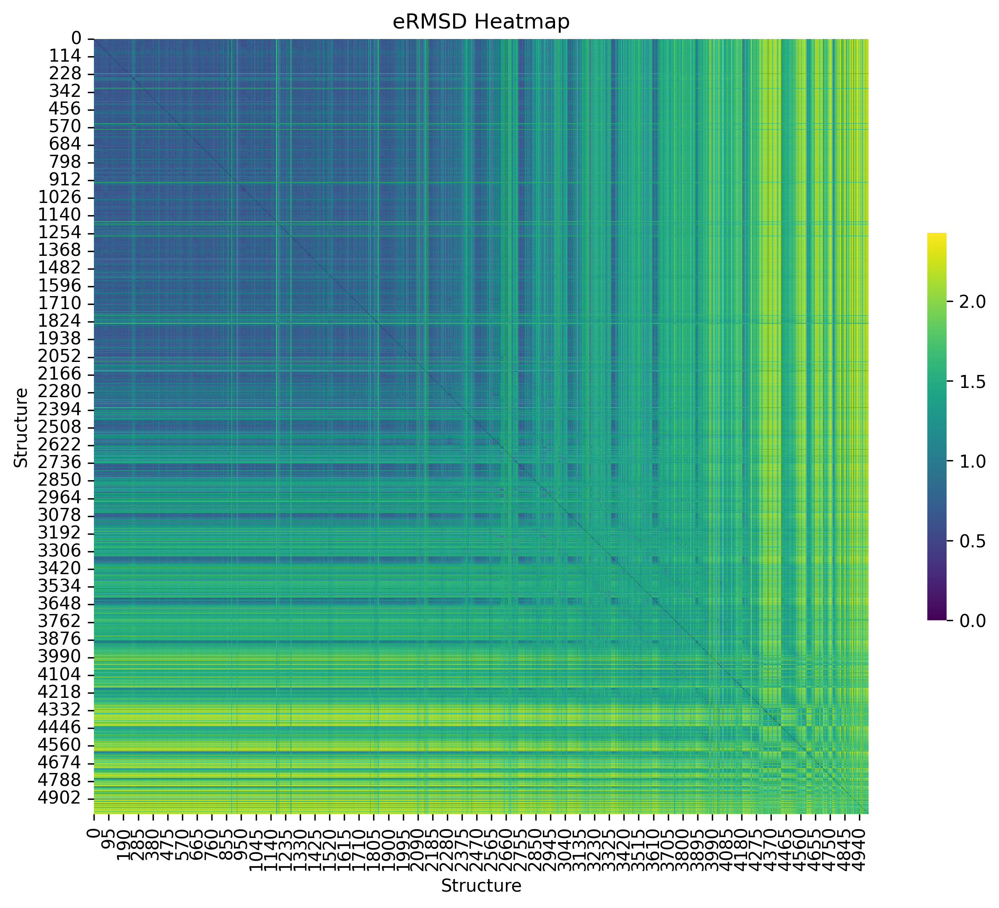

In [12]:
visualize_ermsd_matrix(ermsd_matrix)

In [13]:
# Assuming nrmsd_matrix is your full square eRMSD matrix
condensed_matrix = squareform(ermsd_matrix)

In [14]:
# Using Ward's method for clustering
Z = linkage(condensed_matrix, method='ward')

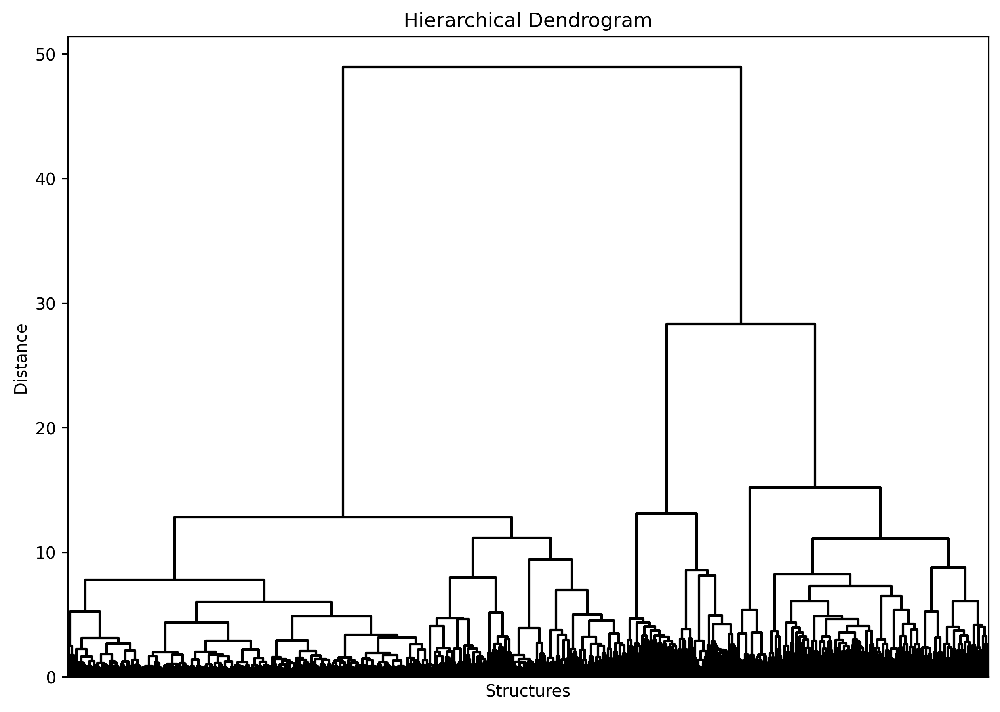

In [15]:
plt.figure(figsize=(10, 7), dpi=300, facecolor='w')
plt.title('Hierarchical Dendrogram')
plt.xlabel('Structures')
plt.ylabel('Distance')

dendrogram(
    Z,
    color_threshold=0,  # Ensures a single color for all branches
    leaf_rotation=90.,  # rotates the x axis labels
    leaf_font_size=8.,  # font size for the x axis labels
    no_labels=True,  # Hide the leaf labels
    above_threshold_color='k',  # Set the color above the threshold to black
)

plt.show()


In [16]:
max_d = 12  # Adjust this threshold to get the desired number of clusters
clusters = fcluster(Z, max_d, criterion='distance')

# Assuming 'clusters' contains the cluster labels for each spectrum
unique_clusters, counts = np.unique(clusters, return_counts=True)

# Print the number of clusters
num_clusters = len(unique_clusters)
print(f"Number of clusters formed: {num_clusters}")

# Optionally, print the number of spectra in each cluster
for cluster, count in zip(unique_clusters, counts):
    print(f"Cluster {cluster} contains {count} structures")


Number of clusters formed: 6
Cluster 1 contains 1959 structures
Cluster 2 contains 1079 structures
Cluster 3 contains 277 structures
Cluster 4 contains 315 structures
Cluster 5 contains 172 structures
Cluster 6 contains 1198 structures


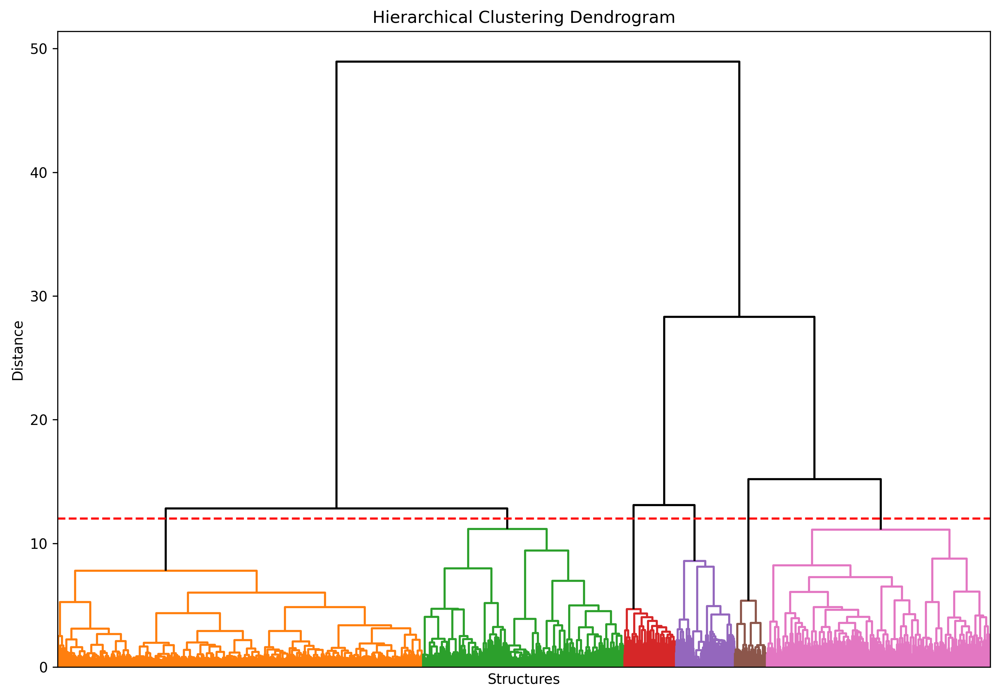

In [17]:
plt.figure(figsize=(10, 7), dpi=300, facecolor='w')
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Structures')
plt.ylabel('Distance')

dendrogram_result = dendrogram(
    Z,
    color_threshold=max_d,
    leaf_rotation=90.,
    leaf_font_size=8.,
    no_labels=True,  # Hide the leaf labels
    above_threshold_color='k',  # Set the color above the threshold to black
)

# Draw a horizontal line at the cut-off distance
plt.axhline(y=max_d, color='r', linestyle='--')

plt.tight_layout()
plt.show()


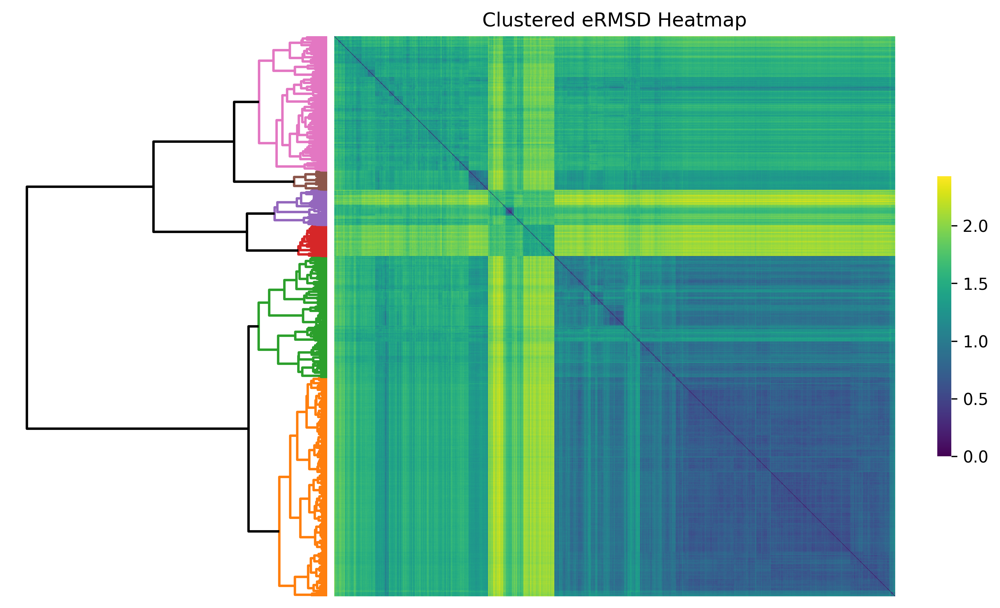

In [18]:
visualize_clustered_ermsd_matrix(ermsd_matrix, Z, max_d)

In [26]:
pdb_folder = '/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection'  # Update this path
output_folder = '/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters'  # Update this path


In [27]:
import glob

# Get all .pdb files from the specified directory
all_pdb_files = []
for file in glob.glob(pdb_folder+"/*.pdb"):
    all_pdb_files.append(file)
    all_pdb_files = sorted(all_pdb_files)

pdb_files_by_cluster = get_pdb_files_by_cluster(clusters, all_pdb_files)

In [29]:
def write_cluster_assignments(clusters, all_pdb_files, output_file):
    """
    Writes a text file listing each PDB file and its assigned cluster.

    Parameters:
    clusters (list): List of cluster indices corresponding to each PDB file.
    all_pdb_files (list): List of PDB file paths, ordered identically to clusters.
    output_file (str): Path to the output text file.
    """
    if len(clusters) != len(all_pdb_files):
        raise ValueError("Length of clusters and all_pdb_files must match.")
    
    with open(output_file, 'w') as f:
        for pdb, cluster in zip(all_pdb_files, clusters):
            f.write(f"{os.path.basename(pdb)}\t{cluster}\n")
    
    print(f"Cluster assignments written to {output_file}")

output_file = "/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/pdb_cluster_assignments_ermsd.txt"
write_cluster_assignments(clusters, all_pdb_files, output_file)

Cluster assignments written to /Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/pdb_cluster_assignments_ermsd.txt


In [53]:
# Save the cluster trajectories
save_cluster_trajectories(pdb_files_by_cluster, output_folder)

/Users/mdellepi/Developer/env_md_analysis/lib/python3.10/site-packages/MDAnalysis/topology/PDBParser.py:331: UserWarning: Element information is missing, elements attribute will not be populated. If needed these can be guessed using MDAnalysis.topology.guessers.
  warnings.warn("Element information is missing, elements attribute "
/Users/mdellepi/Developer/env_md_analysis/lib/python3.10/site-packages/MDAnalysis/coordinates/PDB.py:1151: UserWarning: Found no information for attr: 'elements' Using default value of ' '
  warnings.warn("Found no information for attr: '{}'"
/Users/mdellepi/Developer/env_md_analysis/lib/python3.10/site-packages/MDAnalysis/coordinates/PDB.py:1151: UserWarning: Found no information for attr: 'formalcharges' Using default value of '0'
  warnings.warn("Found no information for attr: '{}'"


Cluster trajectory files have been saved.


In [19]:
def compute_average_ermsd_per_cluster(ermsd_matrix, clusters):
    """
    Computes the average eRMSD for each cluster.
    
    Parameters:
    ermsd_matrix (np.array): The eRMSD matrix.
    clusters (np.array): Array containing cluster labels for each PDB structure.
    
    Returns:
    dict: A dictionary with cluster ids as keys and their average eRMSD as values.
    """
    unique_clusters = np.unique(clusters)
    cluster_averages = {}
    
    for cluster_id in unique_clusters:
        # Get indices of structures in the current cluster
        cluster_indices = np.where(clusters == cluster_id)[0]
        
        # Extract the submatrix corresponding to the current cluster
        cluster_ermsd_values = ermsd_matrix[np.ix_(cluster_indices, cluster_indices)]
        
        # Compute the average eRMSD for the current cluster
        average_ermsd = np.mean(cluster_ermsd_values)
        cluster_averages[cluster_id] = average_ermsd
    
    return cluster_averages

# Compute the average eRMSD for each cluster
average_ermsd_per_cluster = compute_average_ermsd_per_cluster(ermsd_matrix, clusters)

# Print the average eRMSD for each cluster
for cluster_id, avg_ermsd in average_ermsd_per_cluster.items():
    print(f"Cluster {cluster_id} has an average eRMSD of {avg_ermsd:.2f}")

Cluster 1 has an average eRMSD of 0.72
Cluster 2 has an average eRMSD of 1.11
Cluster 3 has an average eRMSD of 1.41
Cluster 4 has an average eRMSD of 1.57
Cluster 5 has an average eRMSD of 0.97
Cluster 6 has an average eRMSD of 1.41


In [20]:
# Get all .cd files from the specified directory
all_cd_files = []
for file in glob.glob("/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/*.cd"):
    all_cd_files.append(file)
    all_cd_files = sorted(all_cd_files)

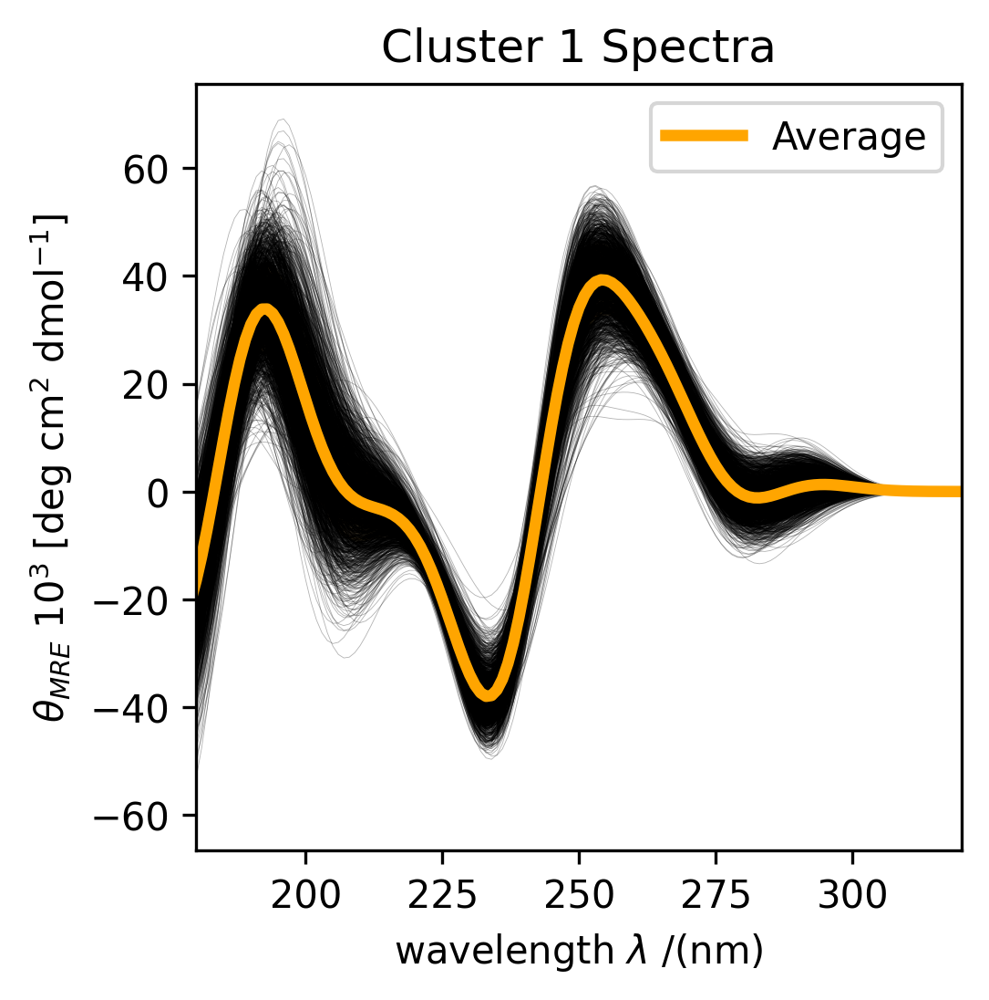

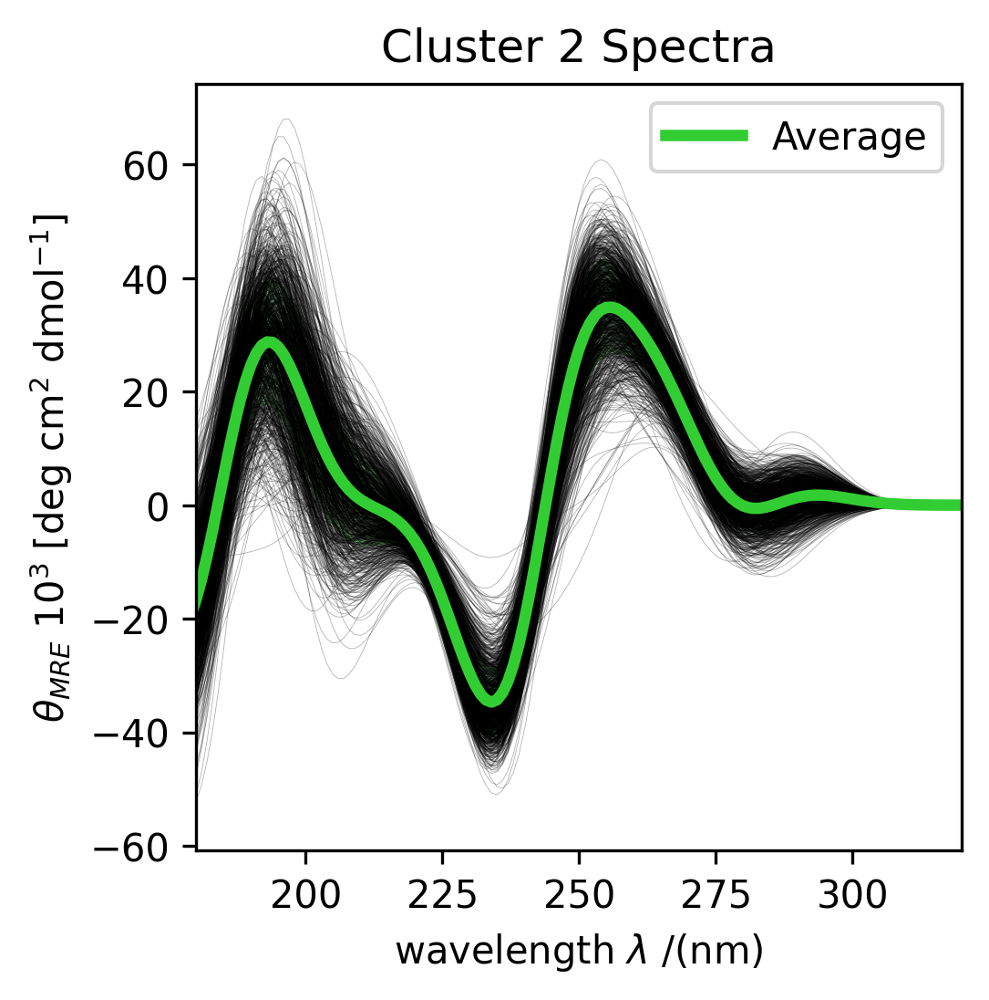

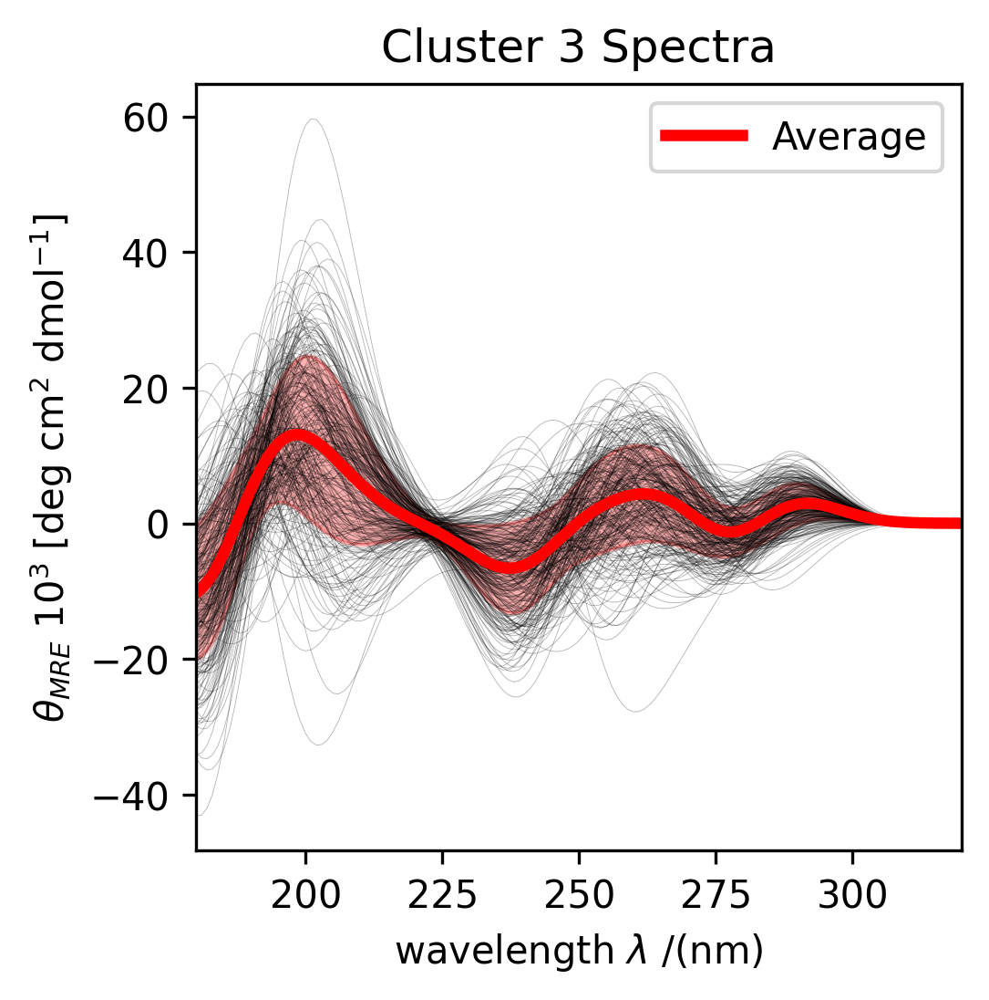

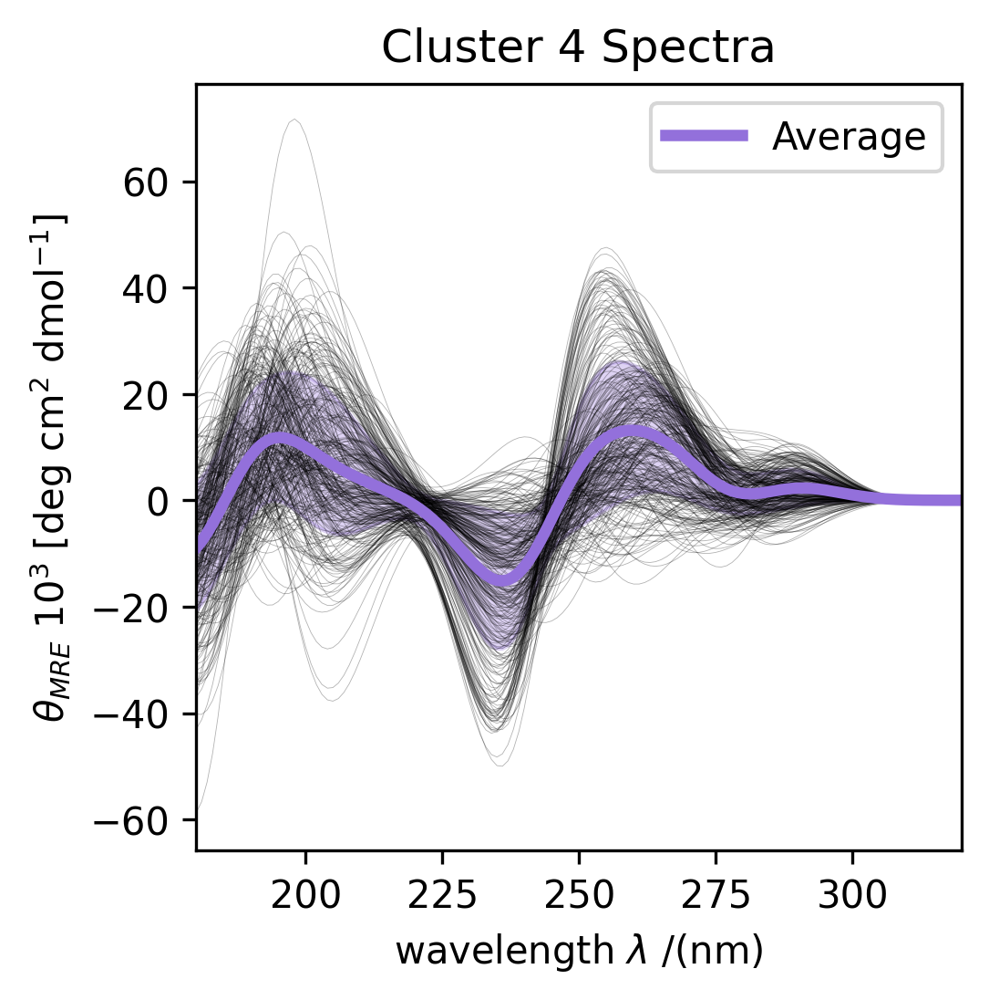

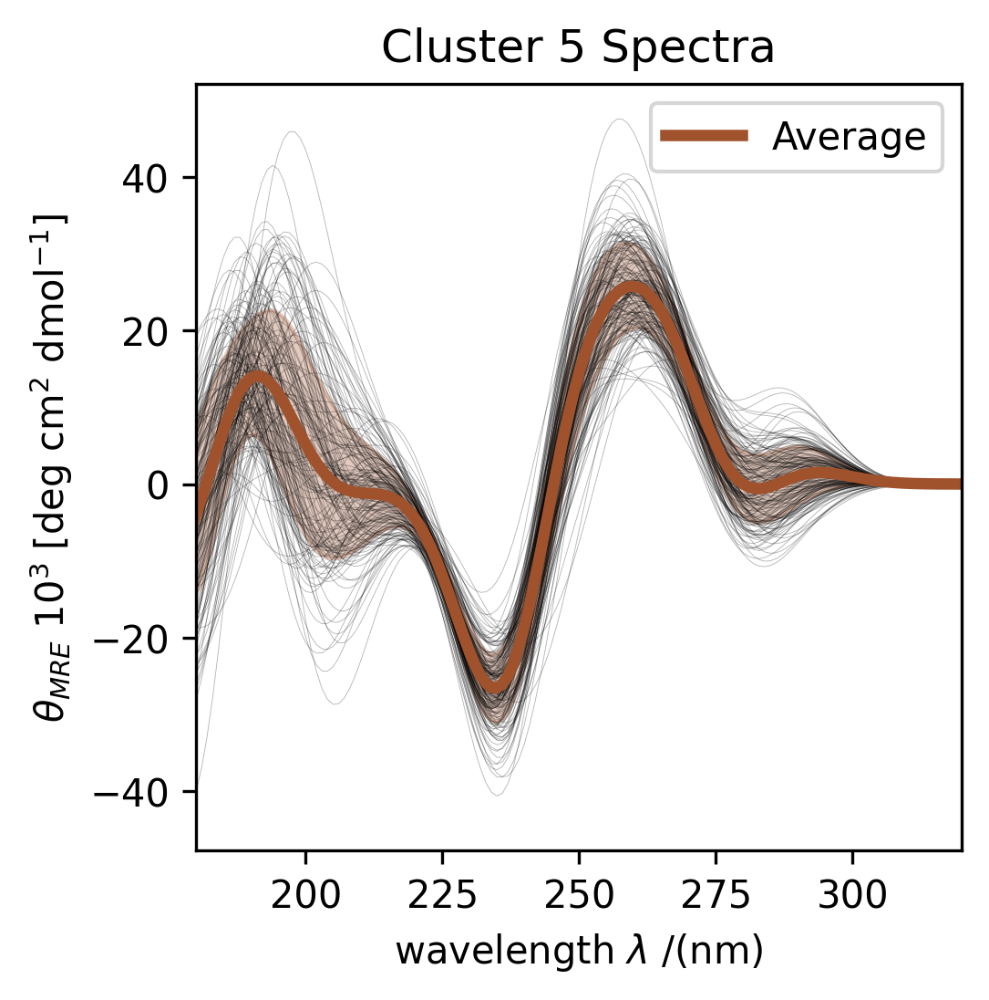

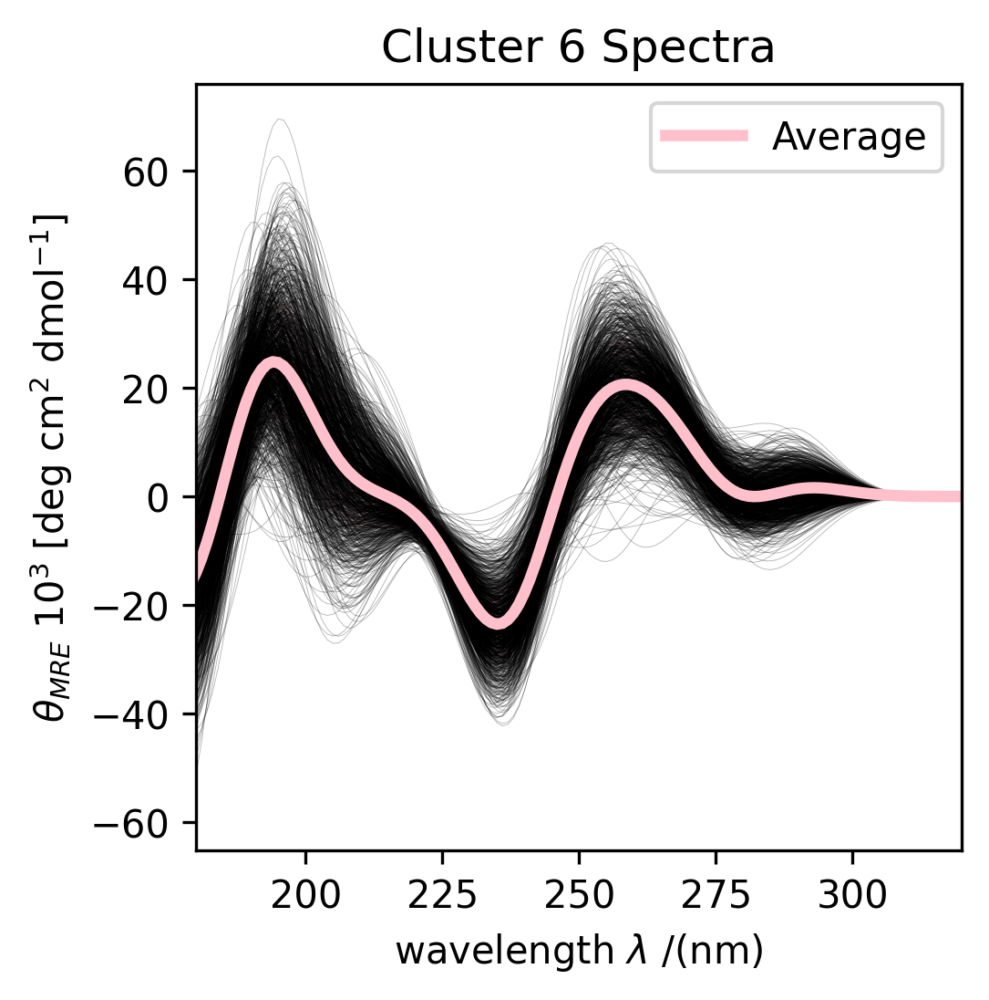

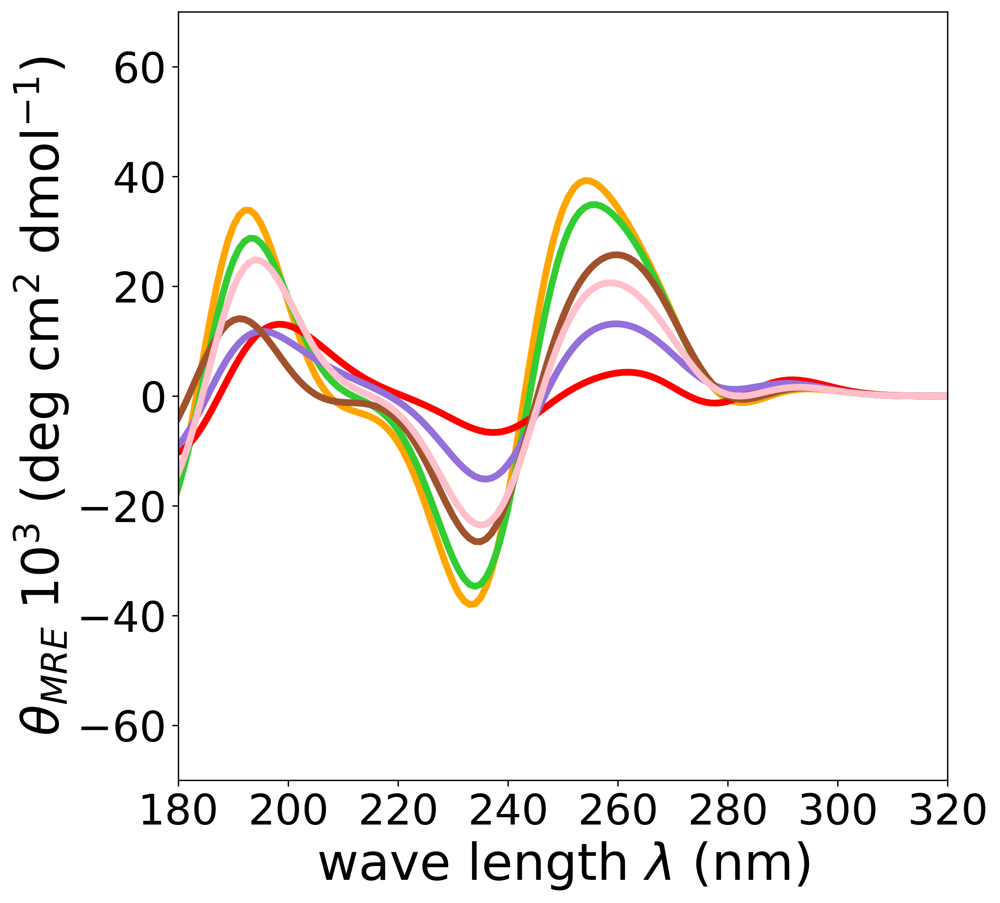

In [21]:
plot_cluster_spectra(clusters, all_cd_files)

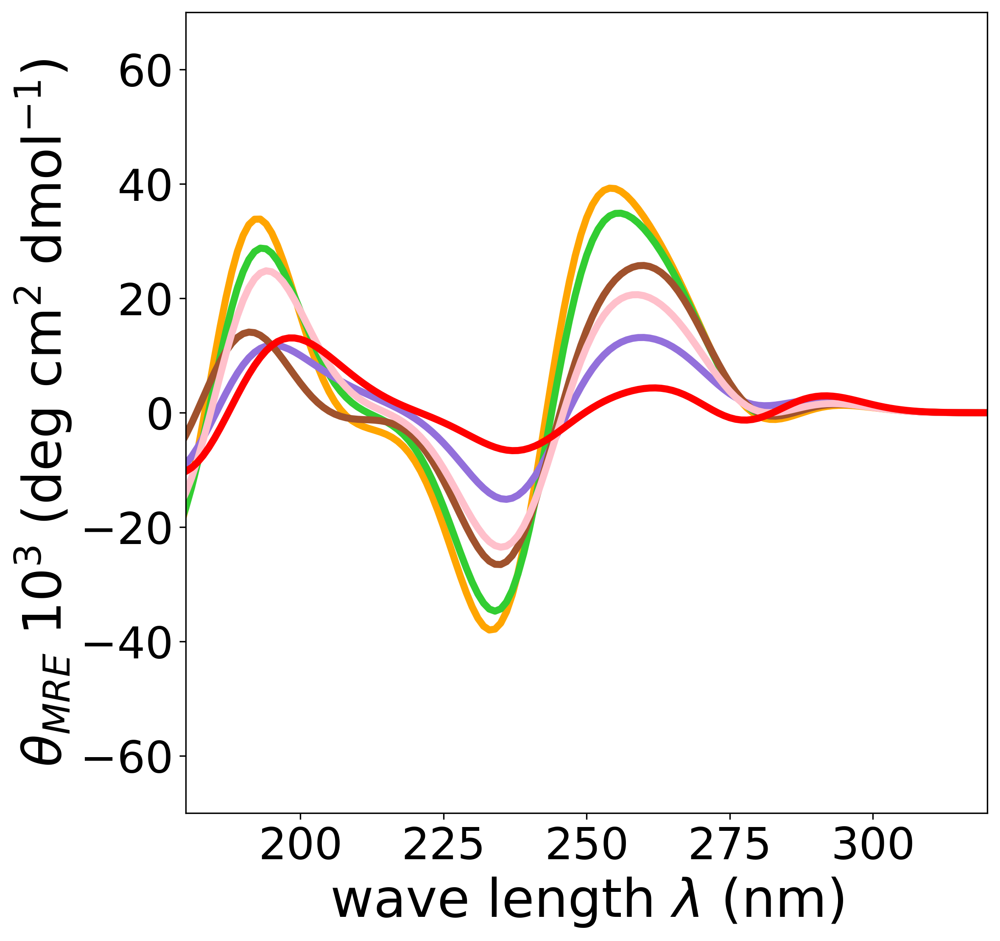

In [24]:
def plot_cluster_average_spectra(clusters, all_cd_files):
    """
    Plots the average spectra of all clusters in a single figure.
    
    Parameters:
    clusters (array): An array with cluster labels for each spectrum.
    all_cd_files (list): List of file paths for the spectra.
    """
    import matplotlib.pyplot as plt
    import numpy as np

    color_sequence = ['orange', 'limegreen', 'r', 'mediumpurple', 'sienna', 'pink']
    color_mapping = {i+1: color_sequence[i] if i < len(color_sequence) else 'black' for i in range(len(set(clusters)))}

    # Group files by cluster
    from collections import defaultdict
    cluster_files = defaultdict(list)
    for file, cluster in zip(all_cd_files, clusters):
        cluster_files[cluster].append(file)

    cluster_averages = {}

    # Compute average spectra per cluster
    for cluster, files in cluster_files.items():
        all_spectra = []
        for file in files:
            wavelength, intensity = parse_cd_file(file)
            all_spectra.append(intensity)
        average_spectrum = np.mean(all_spectra, axis=0)
        cluster_averages[cluster] = (wavelength, average_spectrum)

    # Plot only the average spectra for each cluster
    fig = plt.figure(figsize=(9, 9), dpi=300, facecolor='w')
    plt.subplots_adjust(left=0.15, bottom=0.15, right=0.85, top=0.85)

    for cluster, (wavelength, avg_spectrum) in cluster_averages.items():
        color = color_mapping.get(cluster, 'black')
        plt.plot(wavelength, avg_spectrum, color=color, linewidth=4, label=f'Cluster {cluster}')

    plt.xlabel(r'wave length $\lambda$ (nm)', fontsize=30)
    plt.ylabel(r'$\theta_{MRE}$ $10^3$ (deg cm$^2$ dmol$^{-1}$)', fontsize=30)
    plt.ylim([-70,70])
    plt.xlim([180,320])

    ax = plt.gca()
    ax.tick_params(axis='both', labelsize=25)

    #plt.legend(fontsize=20)
    plt.show()

plot_cluster_average_spectra(clusters, all_cd_files)

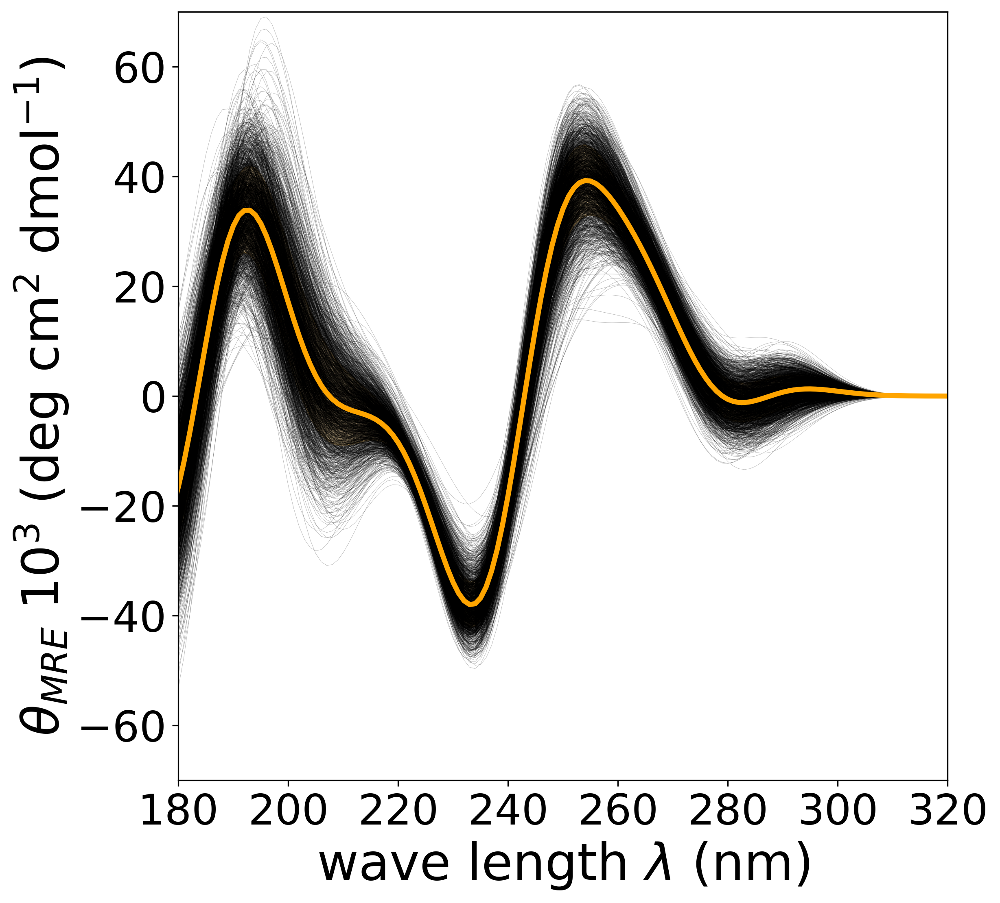

In [51]:
plot_cluster_spectra_single(clusters, all_cd_files, 1, "orange")

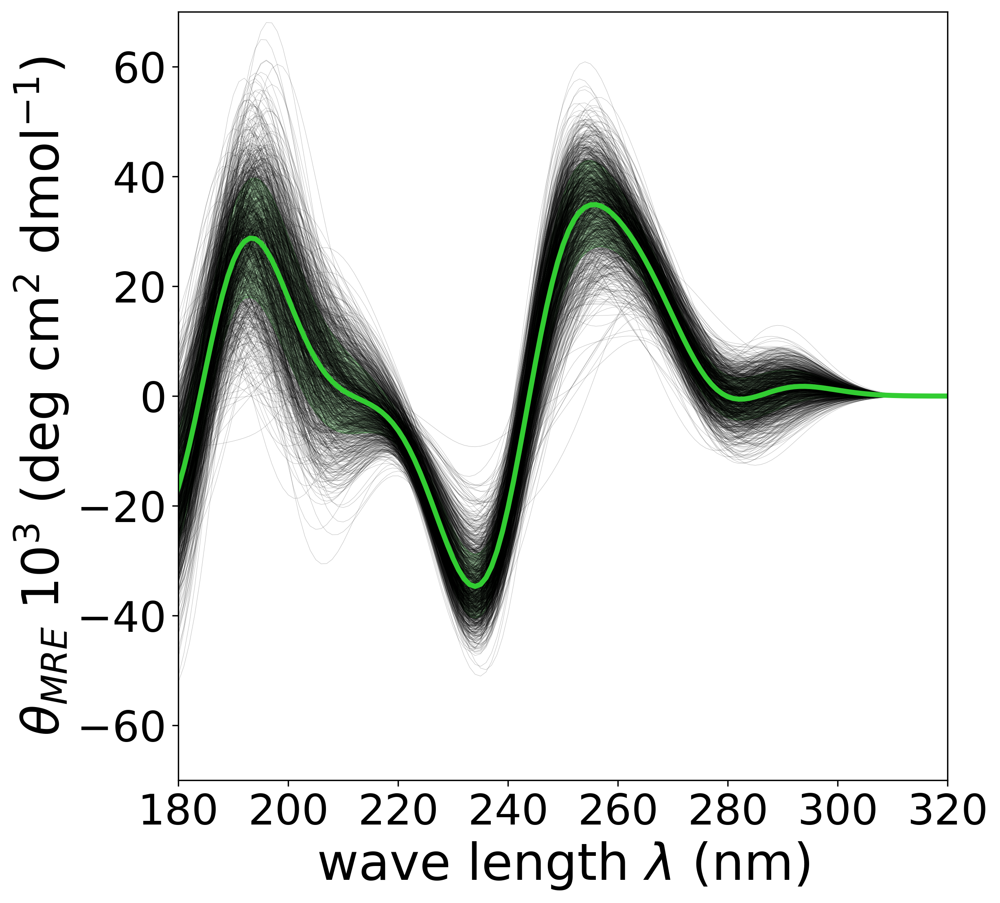

In [52]:
plot_cluster_spectra_single(clusters, all_cd_files, 2, "limegreen")

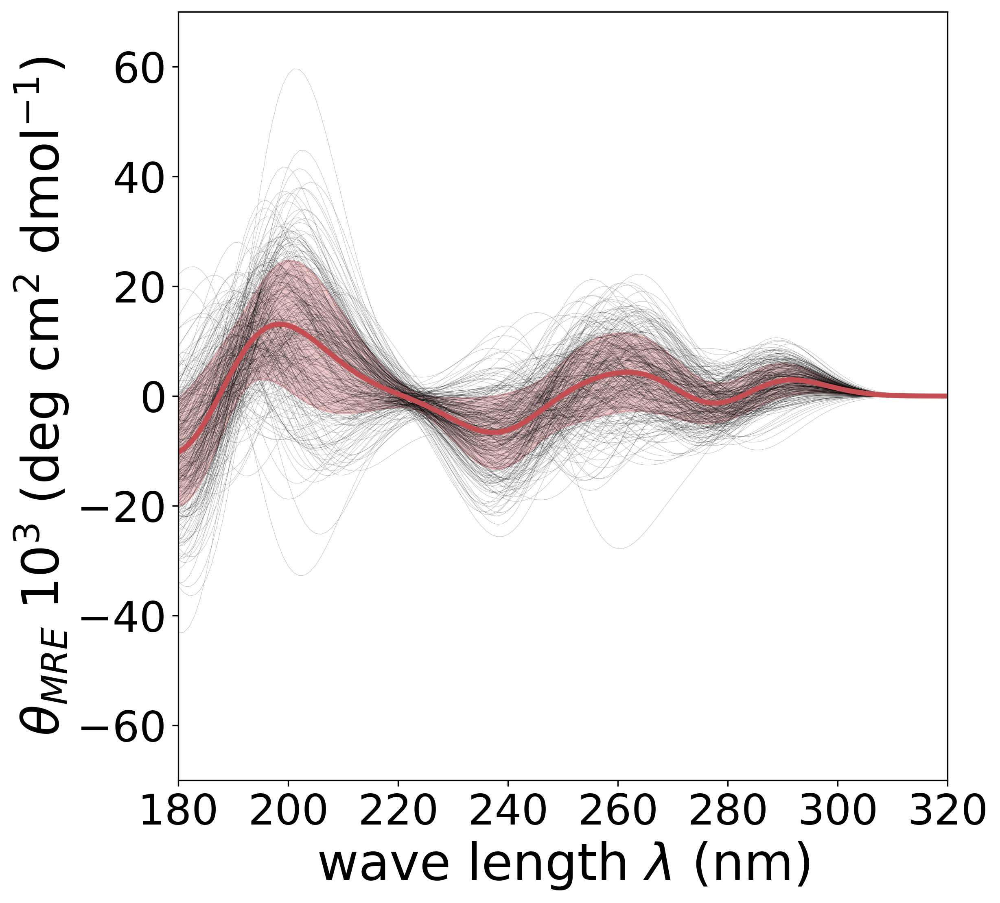

In [53]:
plot_cluster_spectra_single(clusters, all_cd_files, 3, "r")

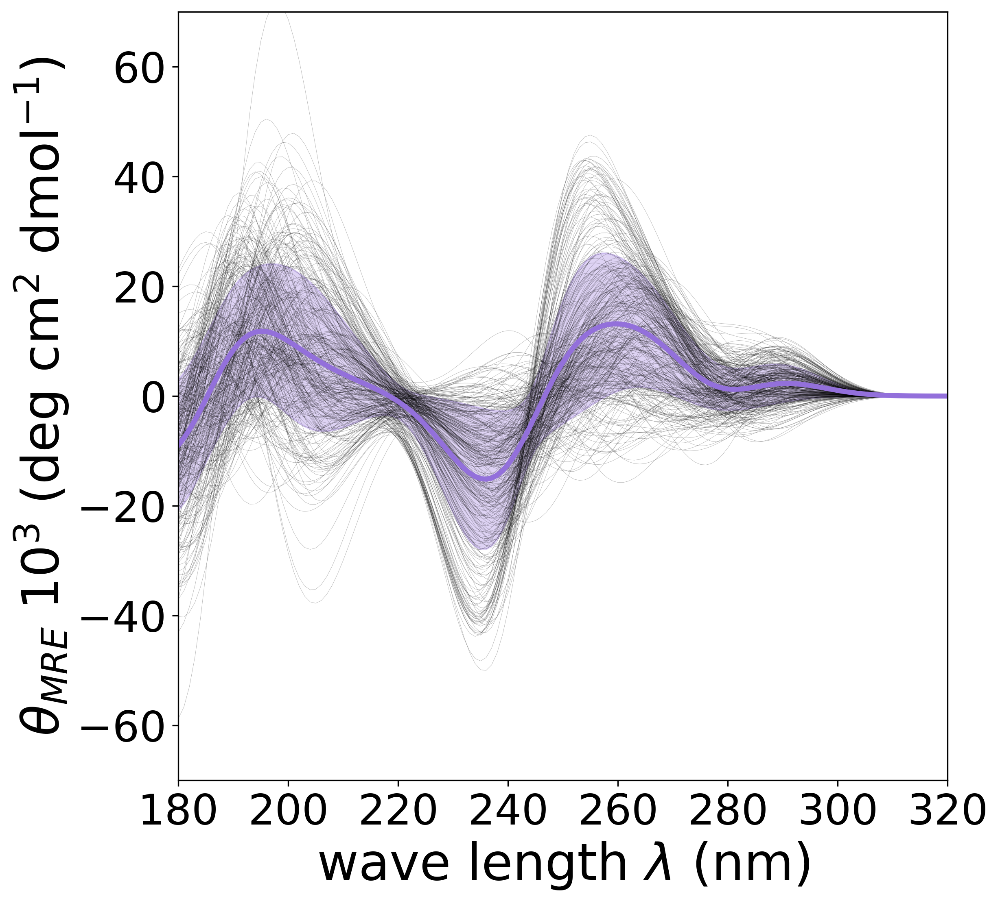

In [54]:
plot_cluster_spectra_single(clusters, all_cd_files, 4, "mediumpurple")

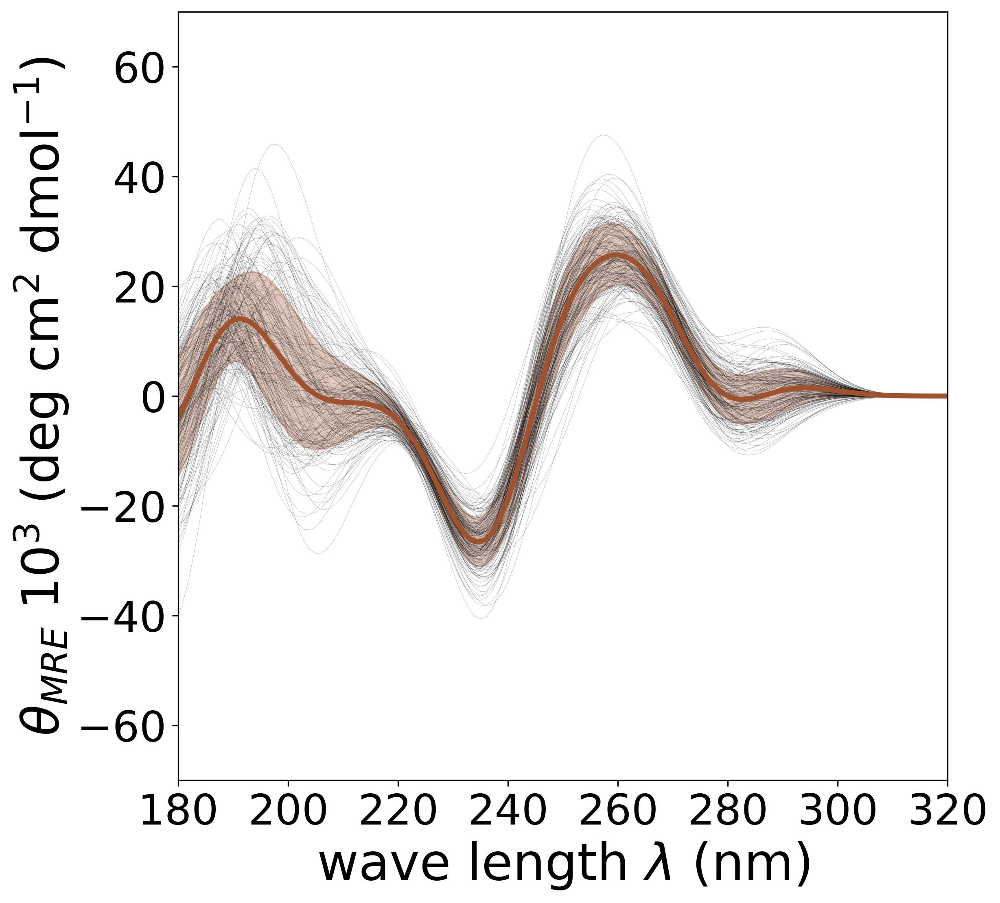

In [55]:
plot_cluster_spectra_single(clusters, all_cd_files, 5, "sienna")

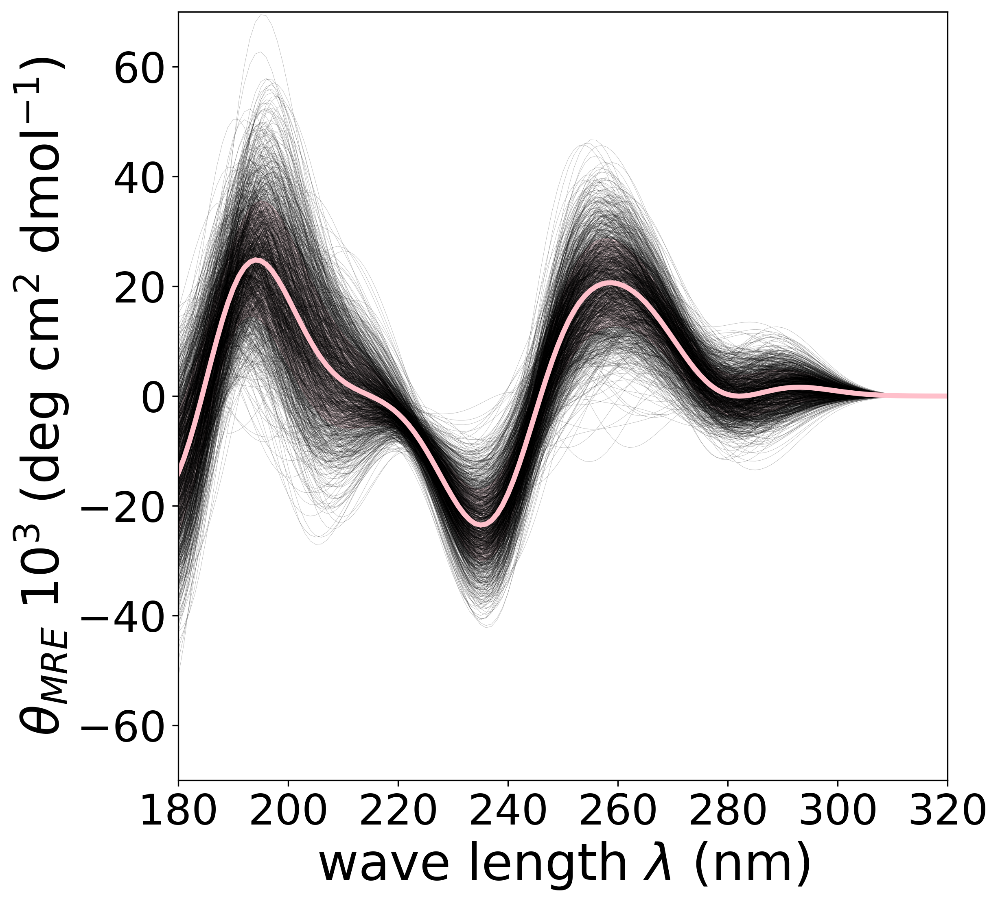

In [56]:
plot_cluster_spectra_single(clusters, all_cd_files, 6, "pink")

In [59]:
import barnaba as bb
import matplotlib.pyplot as plt
from collections import Counter
import numpy as np
import seaborn as sns
from collections import defaultdict

In [60]:
# Define the sequences
sequence1 = "GUCCAGUUUUCCCAGGAAUCCCU"
sequence2 = "GGAUUCCUGGAAAUACUGUUCU"

In [61]:
# Function to preprocess interaction types by removing c/t suffixes
def preprocess_interaction(interaction):
    if interaction[-1] in 'ct':
        return interaction[:-1]
    return interaction

In [62]:
# Function to annotate and normalize interaction matrices for a given PDB file
def annotate_and_normalize(pdb_path, sequence1, sequence2):
    stackings, pairings, res = bb.annotate(pdb_path)
    interaction_matrices = defaultdict(lambda: np.zeros((len(sequence1), len(sequence2))))
    total_structures = len(stackings)
    
    # Create a dictionary to map residues to their indices
    base_indices = {res: idx for idx, res in enumerate(res)}
    
    for structure_index in range(total_structures):
        selected_pairings = pairings[structure_index]
        
        for p in range(len(selected_pairings[0])):
            res1 = res[selected_pairings[0][p][0]]
            res2 = res[selected_pairings[0][p][1]]
            
            # Filter out intra-strand interactions
            if res1.endswith('_0') and res2.endswith('_1') or res1.endswith('_1') and res2.endswith('_0'):
                original_interaction = selected_pairings[1][p]
                interaction = preprocess_interaction(original_interaction)
                index1 = base_indices[res1]
                index2 = base_indices[res2] - len(sequence1)  # Adjust index for second strand
                interaction_matrices[interaction][index1, index2] += 1
    
    # Normalize the interaction matrices by the total number of structures
    for interaction in interaction_matrices:
        interaction_matrices[interaction] /= total_structures
    
    return interaction_matrices

In [63]:
# Paths to the PDB files for each cluster
pdb_paths = [
    "/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_1_chains.pdb",
    "/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_2_chains.pdb",
    "/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_3_chains.pdb",
    "/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_4_chains.pdb",
    "/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_5_chains.pdb",
    "/Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_6_chains.pdb"
]

# Annotate and normalize interaction matrices for each cluster
all_interaction_matrices = [annotate_and_normalize(pdb_path, sequence1, sequence2) for pdb_path in pdb_paths]

# Loading /Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_1_chains.pdb 
# Loading /Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_2_chains.pdb 
# Loading /Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_3_chains.pdb 
# Loading /Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_4_chains.pdb 
# Loading /Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_selection/clusters/cluster_5_chains.pdb 
# Loading /Users/mdellepi/Simulation_data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/pdb_sel

In [64]:
# Function to count the total number of WC interactions between strands for a given matrix
def count_wc_interactions(interaction_matrices):
    wc_counts = []
    for matrices in interaction_matrices:
        wc_matrix = matrices.get("WC", np.zeros((len(sequence1), len(sequence2))))
        wc_count = np.sum(wc_matrix)
        wc_counts.append(wc_count)
    return wc_counts

# Count WC interactions for all clusters
wc_counts = count_wc_interactions(all_interaction_matrices)


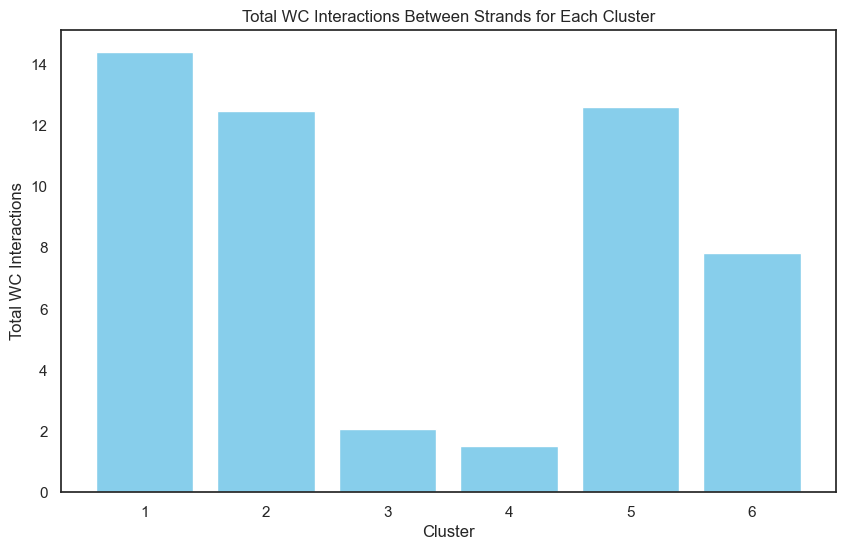

In [65]:
# Plotting the histogram of WC interactions
plt.figure(figsize=(10, 6))
plt.bar(range(1, len(wc_counts) + 1), wc_counts, color='skyblue')
plt.xlabel('Cluster')
plt.ylabel('Total WC Interactions')
plt.title('Total WC Interactions Between Strands for Each Cluster')
plt.xticks(range(1, len(wc_counts) + 1))
plt.show()


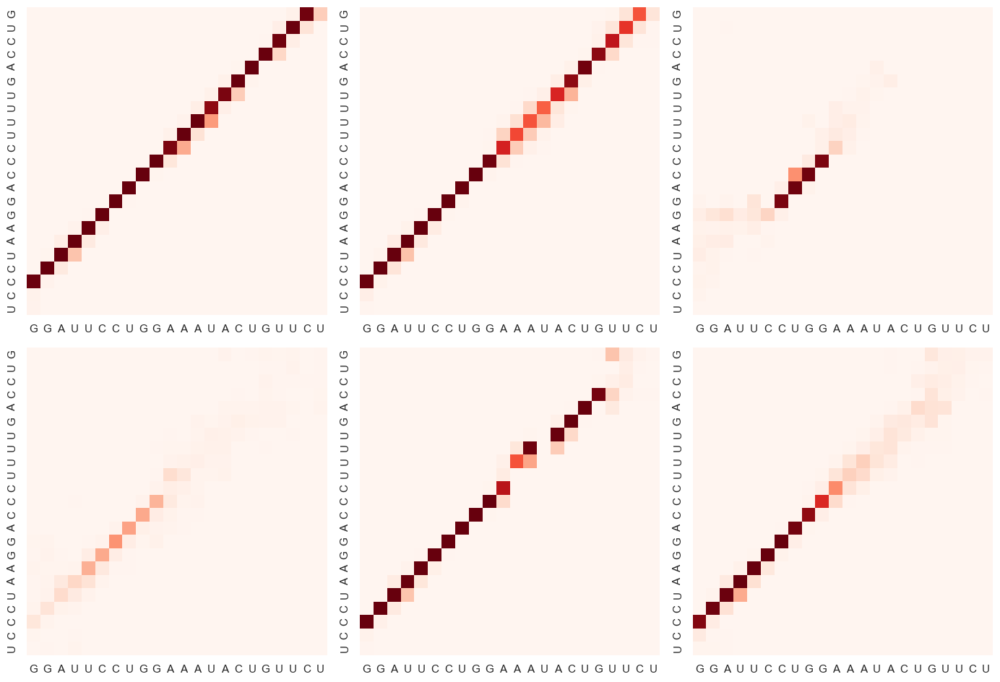

In [66]:
from matplotlib.gridspec import GridSpec

# Aggregate all interaction types into a single matrix for each cluster
combined_matrices = []
for matrices in all_interaction_matrices:
    combined_matrix = np.zeros((len(sequence1), len(sequence2)))
    for interaction, matrix in matrices.items():
        combined_matrix += matrix
    combined_matrices.append(combined_matrix)

# Find the maximum observed probability across all clusters
max_observed_probability = max(np.max(matrix) for matrix in combined_matrices)

# Visualize the combined matrices using heatmaps with a uniform color scale
fig, axes = plt.subplots(2, 3, figsize=(14, 10))
#fig.suptitle("Combined Interaction Frequencies Across Clusters", fontsize=16)
gs = GridSpec(2, 3, figure=fig, wspace=0.1, hspace=0.1)

for i, (matrix, ax) in enumerate(zip(combined_matrices, axes.flatten())):
    sns.heatmap(matrix, annot=False, fmt=".2f", cmap="Reds", vmin=0, vmax=max_observed_probability,
                        xticklabels=list(sequence2), yticklabels=list(sequence1), ax=ax, cbar=False)
    #ax.set_title(f"Cluster {i + 1}")
    #ax.set_xlabel('Nucleobase')
    #ax.set_ylabel('Nucleobase')

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


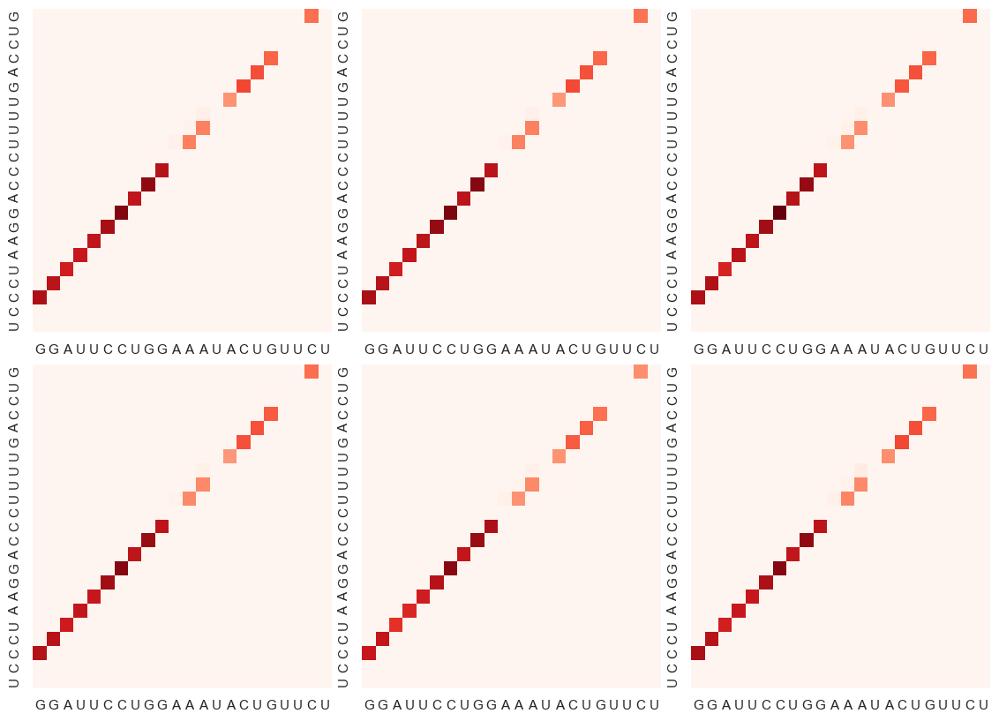

In [43]:
from matplotlib.gridspec import GridSpec

# Get the set of all unique interactions across all clusters
all_interactions = set()
for matrices in all_interaction_matrices:
    all_interactions.update(matrices.keys())

# Visualize the matrices using heatmaps
for interaction in all_interactions:
    if interaction == 'WC':
        fig = plt.figure(figsize=(14, 10))
        #fig.suptitle(f"Frequency of {interaction} Interactions Across Clusters", fontsize=16)
        gs = GridSpec(2, 3, figure=fig, wspace=0.1, hspace=0.1)

        # Find the maximum observed probability for the specific interaction
        max_observed_probability = max(np.max(matrices.get(interaction, np.zeros((len(sequence1), len(sequence2))))) for matrices in all_interaction_matrices)

        axes = []
        for i in range(len(all_interaction_matrices)):
            ax = fig.add_subplot(gs[i // 3, i % 3])
            axes.append(ax)
            matrix = all_interaction_matrices[i].get(interaction, np.zeros((len(sequence1), len(sequence2))))
            sns.heatmap(matrix, annot=False, fmt=".2f", cmap="Reds", vmin=0, vmax=max_observed_probability,
                        xticklabels=list(sequence2), yticklabels=list(sequence1), ax=ax, cbar=False)
            #ax.set_title(f"Cluster {i + 1}")
            #ax.set_xlabel('Nucleobase (Strand 2)')
            #ax.set_ylabel('Nucleobase (Strand 1)')

        # Add a single shared colorbar
        #cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # Position: [left, bottom, width, height]
        #sns.heatmap(np.zeros((len(sequence1), len(sequence2))), cmap="Reds", cbar=True,
        #            cbar_ax=cbar_ax, vmin=0, vmax=max_observed_probability)
        #cbar_ax.set_ylabel('Interaction Frequency')

        plt.show()

In [41]:
# Create a new dictionary for the eRMSD clusters
cd_files_by_eRMSD_cluster = {}

# Populate the new dictionary with file paths according to the new clusters
for idx, cluster in enumerate(clusters):
    cluster = int(cluster)  # Ensure the cluster key is of type int
    if cluster not in cd_files_by_eRMSD_cluster:
        cd_files_by_eRMSD_cluster[cluster] = []
    cd_files_by_eRMSD_cluster[cluster].append(all_cd_files[idx])

# Save the new dictionary as a JSON file
with open('/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/cd_files_by_eRMSD_cluster.json', 'w') as file:
    json.dump(cd_files_by_eRMSD_cluster, file, indent=4)

print("New JSON file 'cd_files_by_eRMSD_cluster.json' created successfully.")

New JSON file 'cd_files_by_eRMSD_cluster.json' created successfully.


In [42]:
# Load the CD cluster data
with open('/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/cd_files_by_cd_cluster.json', 'r') as file:
    cd_cluster_data = json.load(file)

# Load the eRMSD cluster data
with open('/Volumes/Sim_Data/uni-bremen/miRNA/data/Sim/MD_duplex/amber99_parmbsc_chiOL3/REST/CD/DUPLEXES/selection/cd_files_by_eRMSD_cluster.json', 'r') as file:
    rmsd_cluster_data = json.load(file)

In [43]:
# Ensure keys are strings for consistency
cd_cluster_data = {str(k): v for k, v in cd_cluster_data.items()}
rmsd_cluster_data = {str(k): v for k, v in rmsd_cluster_data.items()}

In [44]:
def find_cluster(file_path, cluster_data):
    for cluster_id, file_paths in cluster_data.items():
        if file_path in file_paths:
            return cluster_id
    return None

In [45]:
rmsd_to_cd_mapping = {}

for rmsd_cluster, files in rmsd_cluster_data.items():
    cd_clusters = {}
    for file_path in files:
        cd_cluster = find_cluster(file_path, cd_cluster_data)
        if cd_cluster:
            cd_clusters[cd_cluster] = cd_clusters.get(cd_cluster, 0) + 1
    rmsd_to_cd_mapping[rmsd_cluster] = cd_clusters

In [46]:
cd_to_rmsd_mapping = {}

for cd_cluster, files in cd_cluster_data.items():
    rmsd_clusters = {}
    for file_path in files:
        rmsd_cluster = find_cluster(file_path, rmsd_cluster_data)
        if rmsd_cluster:
            rmsd_clusters[rmsd_cluster] = rmsd_clusters.get(rmsd_cluster, 0) + 1
    cd_to_rmsd_mapping[cd_cluster] = rmsd_clusters

In [39]:
# Prepare the data in the correct format
similarity_matrix = np.zeros((len(rmsd_cluster_data), len(cd_cluster_data)))

for rmsd_index, (rmsd_cluster, rmsd_files) in enumerate(rmsd_cluster_data.items()):
    for cd_index, (cd_cluster, cd_files) in enumerate(cd_cluster_data.items()):
        common_files = len(set(rmsd_files) & set(cd_files))
        similarity_matrix[rmsd_index][cd_index] = common_files

# Create a DataFrame for the similarity matrix
similarity_df = pd.DataFrame(similarity_matrix, 
                             index=[f'eRMSD_{key}' for key in rmsd_cluster_data.keys()],
                             columns=[f'CD_{key}' for key in cd_cluster_data.keys()])

# Display the similarity matrix
print("Similarity Matrix:")
print(similarity_df)

# Flatten the matrix for pairwise correlation calculation
flat_similarity = similarity_df.values.flatten()

Similarity Matrix:
          CD_1    CD_2   CD_3   CD_4   CD_5
eRMSD_1  574.0  1292.0    0.0   54.0   39.0
eRMSD_2  280.0   443.0    1.0  242.0  113.0
eRMSD_4    5.0    24.0  173.0   51.0   62.0
eRMSD_5    1.0    10.0    0.0   35.0  126.0
eRMSD_6   19.0    28.0   35.0  532.0  584.0
eRMSD_3    0.0     0.0  251.0    6.0   20.0


Normalized Similarity Matrix:
             CD_1      CD_2      CD_3      CD_4      CD_5
eRMSD_1  1.980747  2.109021 -0.773863 -0.534406 -0.608449
eRMSD_2  0.618549  0.304932 -0.763769  0.477021 -0.227954
eRMSD_4 -0.655616 -0.585426  0.972375 -0.550546 -0.490187
eRMSD_5 -0.674149 -0.615176 -0.773863 -0.636625 -0.161110
eRMSD_6 -0.590749 -0.576926 -0.420578  2.037200  2.193843
eRMSD_3 -0.678782 -0.636425  1.759696 -0.792643 -0.706143


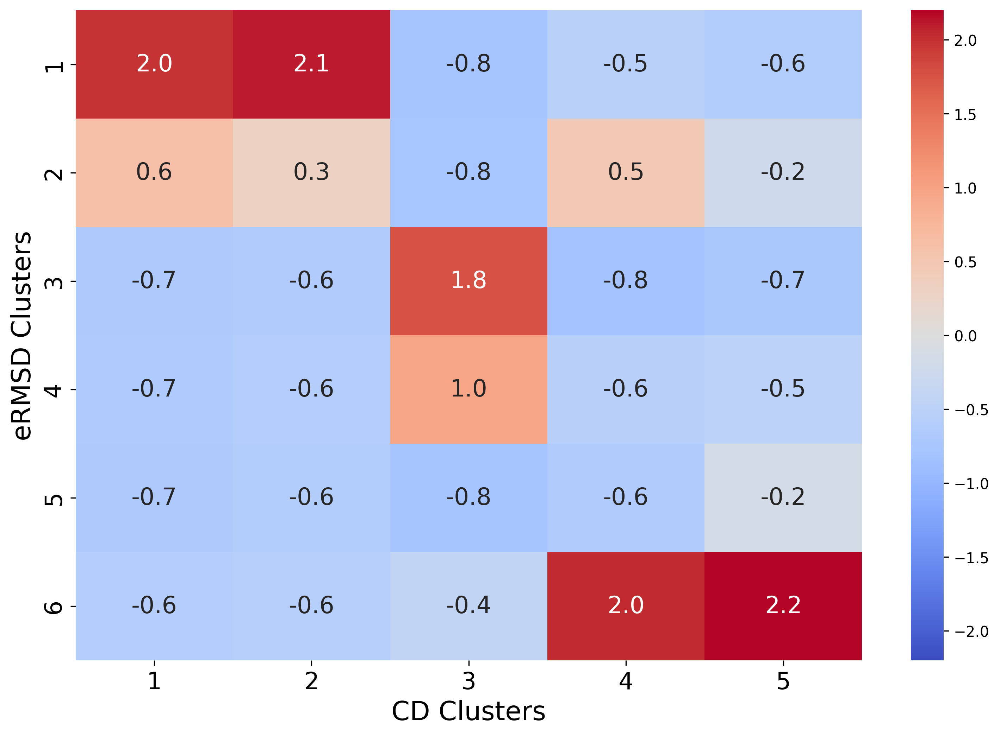

In [40]:
# Normalize the similarity matrix
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
normalized_similarity_matrix = scaler.fit_transform(similarity_matrix)
normalized_similarity_df = pd.DataFrame(normalized_similarity_matrix, 
                                        index=[f'eRMSD_{key}' for key in rmsd_cluster_data.keys()],
                                        columns=[f'CD_{key}' for key in cd_cluster_data.keys()])

print("Normalized Similarity Matrix:")
print(normalized_similarity_df)

# Ensure eRMSD clusters are ordered from 1 to 7
ordered_eRMSD_clusters = [f'eRMSD_{i}' for i in range(1, 7)]
ordered_normalized_similarity_df = normalized_similarity_df.loc[ordered_eRMSD_clusters]

# Rename the indices and columns to remove the prefixes
ordered_normalized_similarity_df.index = [i for i in range(1, 7)]
ordered_normalized_similarity_df.columns = [i for i in range(1, len(ordered_normalized_similarity_df.columns) + 1)]

# Plot heatmap for the normalized similarity matrix with one decimal digit
#sns.set(font_scale=1.2)
plt.figure(figsize=(12, 8), dpi=300)
sns.heatmap(ordered_normalized_similarity_df, annot=True, fmt=".1f", cmap='coolwarm', center=0, vmin=-2.2, vmax=2.2, annot_kws={"size": 16})
plt.xlabel('CD Clusters', fontsize=18)
plt.ylabel('eRMSD Clusters', fontsize=18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.show()